In [1]:
##Esteban Hernández
import plotly.graph_objects as go
import plotly.offline as pyo
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

def lblFormat(n, pos): # Funcion para cambiar los exponentes de las valores en y
    if (n==0):
        return str(int(n*10))+"x10^3"
    elif (n!=0):
        return str((int(n / 1e3)))+"x10^3"


#data = pd.read_csv("C:/Users/ESTEBAN/Documents/Scripts_U/git/scripts/Data/FCD/limpia.csv", sep = ",")
#data = pd.read_csv("data.csv",sep=",") 
data = pd.read_csv("/home/_init_/Documentos/Scripts/GIT/scripts/Data/FCD/Data_limpio.csv",sep=",")

#Compar edad con deporte con promedio de todas las edades
eval = "NOC"
df = pd.DataFrame(data[eval].value_counts())

nombres = []    #Lista para crear dataframe nombres y 
mean = []

for a in list(df.index):
    nombres.append(a)
    mean.append(data[data[eval] == a]["Age"].mean())

dframe = pd.DataFrame(mean,nombres)
dframe.columns = ["Promedio Edades"]
dframe.sort_values(by = "Promedio Edades", inplace=True, ascending=True)

dfmean = pd.DataFrame([data["Age"].mean()],columns=["Promedio Edades"],index=["Promedio"]) #Barra promedio en medio
dframe = pd.concat([dframe.head(6),dfmean,dframe.tail(6)]) #Concatenar los 13 datos


c1 = '#d45555' #Crear lista de colores para 13 datos
c2 = '#3580ca'
c3 = '#7acf76'
color = []
for i in range(6): color.append(c1)
color.append(c3)
for i in range(6): color.append(c2)


plt.barh(list(dframe.index),dframe["Promedio Edades"],color = color) #Creación de grafico
plt.xticks([x for x in range(10,36)])
plt.xlim([18,35])

plt.title("Promedio Ordenado de Edades por "+eval, fontsize = 15)
plt.text(30,8, 'Mayores 6 \nPromedios', fontsize=15, color=c2, bbox ={'facecolor':'#e0e0e0', 'pad':10})
plt.text(23,1, 'Menores 6 \nPromedios', fontsize=15, color=c1, bbox ={'facecolor':'#e0e0e0', 'pad':10})
plt.text(27,5, 'Promedio General', fontsize=11, color="#488c45", bbox ={'facecolor':'#e0e0e0', 'pad':8})
plt.grid(alpha = 0.5)
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: 'data.csv'

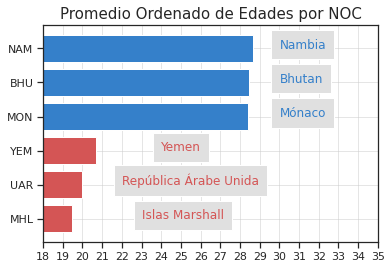

In [ ]:

#Compar edad con deporte con promedio de todas las edades
eval = "NOC"
df = pd.DataFrame(data[eval].value_counts())

nombres = []    #Lista para crear dataframe nombres
mean = []

for a in list(df.index):
    nombres.append(a)
    mean.append(data[data[eval] == a]["Age"].mean())

dframe = pd.DataFrame(mean,nombres)
dframe.columns = ["Promedio Edades"]
dframe.sort_values(by = "Promedio Edades", inplace=True, ascending=True)

dframe = pd.concat([dframe.head(3),dframe.tail(3)]) #Concatenar los 13 datos

c1 = '#d45555' #Crear lista de colores para 13 datos
c2 = '#3580ca'

color = []
for i in range(3): color.append(c1)

for i in range(3): color.append(c2)


plt.barh(list(dframe.index),dframe["Promedio Edades"],color = color) #Creación de grafico
plt.xticks([x for x in range(10,36)])
plt.xlim([18,35])

plt.title("Promedio Ordenado de Edades por "+eval, fontsize = 15)

plt.text(30,5, 'Nambia', fontsize=12, color=c2, bbox ={'facecolor':'#e0e0e0', 'pad':8})
plt.text(30,4, 'Bhutan', fontsize=12, color=c2, bbox ={'facecolor':'#e0e0e0', 'pad':8})
plt.text(30,3, 'Mónaco', fontsize=12, color=c2, bbox ={'facecolor':'#e0e0e0', 'pad':8})
plt.text(24,2, 'Yemen', fontsize=12, color=c1, bbox ={'facecolor':'#e0e0e0', 'pad':8})
plt.text(22,1, 'República Árabe Unida', fontsize=12, color=c1, bbox ={'facecolor':'#e0e0e0', 'pad':8})
plt.text(23,0, 'Islas Marshall', fontsize=12, color=c1, bbox ={'facecolor':'#e0e0e0', 'pad':8})

plt.grid(alpha = 0.5)
plt.show()

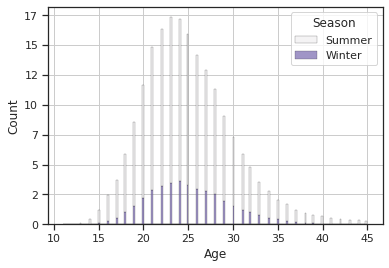

In [ ]:
plt.gca().yaxis.set_major_formatter(lblFormat)
sns.set_theme(style="ticks")
sns.histplot(data=data,x="Age", hue="Season", multiple="stack", palette="light:m", edgecolor=".1", linewidth=.2)
plt.grid()
plt.show()

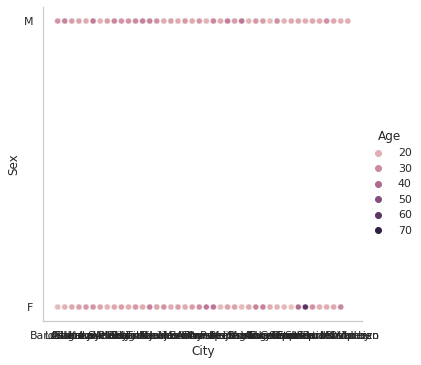

In [ ]:
sns.set_theme(style="whitegrid", palette="muted")
sns.relplot(
    data=data,
    x="City", y="Sex", hue="Age"
)
plt.grid()
plt.show()

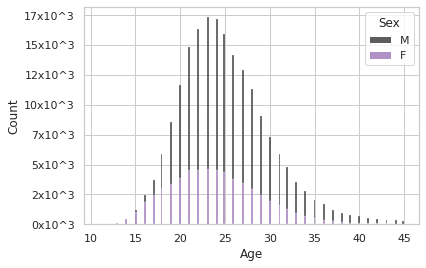

In [ ]:
data_ = data
data = data.drop(data[ data['Age'] > 45 ].index)

plt.gca().yaxis.set_major_formatter(lblFormat)

sns.color_palette("rocket", as_cmap=True)

sns.histplot(data = data, x = "Age", hue="Sex",multiple="stack", palette="dark:m", fill = True)
plt.show()
data = data_

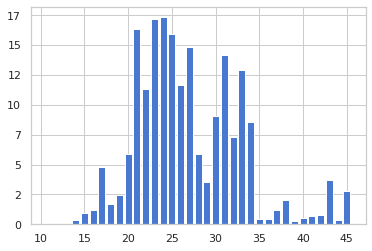

In [ ]:

plt.gca().yaxis.set_major_formatter(lblFormat)


sns.barplot(data = data, x = "Age",y = "", hue="Sex",multiple="stack", palette="dark:m", fill = True)
plt.show()


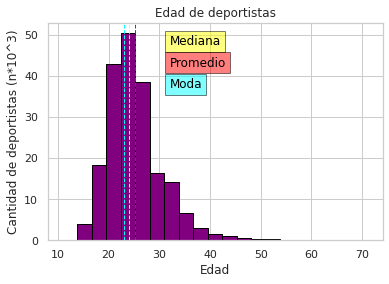

In [ ]:

#Funcion para cambiar el formato del eje y
def lblFormat(n, pos):
    if (n==0):
        return str(int(n*10))
    elif (n!=0):
        return str((int(n / 1e3)))

plt.hist(data['Age'],21, color="purple", ec= "black")
ax = plt.subplot()

plt.axvline(data["Age"].median(), color='yellow', linestyle='--', linewidth=1)
plt.axvline(data["Age"].mean(), color='red', linestyle='dashed', linewidth=1)
plt.axvline(data["Age"].mode().get(0), color='cyan', linestyle='--', linewidth=1)

plt.title('Edad de deportistas')
ax.set_xlabel('Edad')
ax.set_ylabel('Cantidad de deportistas (n*10^3)')

#Añadimos el texto en la linea de la mediana
min_ylim, max_ylim = plt.ylim()
a = plt.text(32, max_ylim*0.9, 'Mediana'.format(data["Age"].median()),color='black')
b = plt.text(32, max_ylim*0.8, 'Promedio'.format(data["Age"].mean()),color='black')
c = plt.text(32, max_ylim*0.7, 'Moda'.format(data["Age"].mean()),color='black')

a.set_bbox(dict(facecolor='yellow', alpha=0.5, edgecolor='black'))
b.set_bbox(dict(facecolor='red', alpha=0.5, edgecolor='black'))
c.set_bbox(dict(facecolor='cyan', alpha=0.5, edgecolor='black'))

#Cambiamos formato de eje y
plt.gca().yaxis.set_major_formatter(lblFormat)
plt.savefig('grafico_sin_outliers.jpg')
plt.show()
plt.close('df5')